In [1]:
import pickle
from commonfunctions import *
import cv2
import os
import matplotlib.pyplot as plt

In [2]:
# #PROCESSING FUNCTIONS##
def auto_rotate_image(image, counter=1):

    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply GaussianBlur to reduce noise and aid contour detection
    blurred = cv2.GaussianBlur(gray, (3, 3), 0)

    # Use Canny edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Find contours in the edged image
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    image_with_contour = image.copy()

    # Find the contour with the maximum area
    max_contour = max(contours, key=cv2.contourArea)

    # Fit a rotated bounding box to the contour
    rect = cv2.minAreaRect(max_contour)

    # Unpack the rectangle information
    (dummy, (width_contour, height_contour), angle) = rect

    # Ensure width is always the larger side
    if width_contour < height_contour:
        width_contour, height_contour = height_contour, width_contour
        angle -= 90

    height, width = image.shape[:2]
    width_ratio = float(width_contour / width)

    #Counter is for the second call of this function, in this call I am interested in getting the new coordinates of the bounding box but no further rotation needed.
    if counter == 0 and width_ratio > 0.65:
        # Rotate the image to the detected angle
        rotated_image = rotating_image(image_with_contour, angle)
        return rotated_image, max_contour
    else:
        return image_with_contour, max_contour

def rotating_image(image, angle):
    # Get the image dimensions
    height, width = image.shape[:2]

    # Calculate the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D((width / 2, height / 2), angle, 1)

    # Determine the new bounding box after rotation
    cos_theta = np.abs(rotation_matrix[0, 0])
    sin_theta = np.abs(rotation_matrix[0, 1])

    new_width = int((width * cos_theta) + (height * sin_theta))
    new_height = int((width * sin_theta) + (height * cos_theta))

    # Adjust the rotation matrix for translation to keep the entire rotated image
    rotation_matrix[0, 2] += (new_width - width) / 2
    rotation_matrix[1, 2] += (new_height - height) / 2

    # Apply the rotation to the image
    rotated_image = cv2.warpAffine(image, rotation_matrix, (new_width, new_height),
                                    borderMode=cv2.BORDER_CONSTANT, borderValue=(255, 255, 255))

    return rotated_image

def crop_image(image, box):
    x, y, w, h = cv2.boundingRect(box)
    if w < h:
        w, h = h, w
    return image[y:y + h, x:x + w]

def Background_Removal(img):
    if img is not None:

      new_image, contour1 = auto_rotate_image(img, 0)
      rect1 = cv2.minAreaRect(contour1)
      box1 = cv2.boxPoints(rect1)
      box1 = np.int0(box1)

      # Unpack the rectangle information
      (dummy, (width_contour1, height_contour1), angle1) = rect1 #dummy variable as the rect returns 3 variables

      # Ensure width is always the larger side
      if width_contour1 < height_contour1:
          width_contour1, height_contour1 = height_contour1, width_contour1
          angle1 -= 90

      rotated_image, contour2 = auto_rotate_image(new_image)
      rect2 = cv2.minAreaRect(contour2)
      box2 = cv2.boxPoints(rect2)
      box2 = np.int0(box2)

      (dummy2, (width_contour2, height_contour2), angle2) = rect2

      # Ensure width is always the larger side
      if width_contour2 < height_contour2:
          width_contour2, height_contour2 = height_contour2, width_contour2
          angle2 -= 90

      if -1 < angle2 < 1:
          cropped_image = crop_image(rotated_image, box2)
      elif -1 < angle1 < 1:
          new_height, new_width = rotated_image.shape[:2]
          # Resize the image to avoid features cropping
          resized_image = cv2.resize(new_image, (new_width, new_height))
          cropped_image = crop_image(resized_image, box1)
      else:
          cropped_image = rotated_image

      return cropped_image

    else:
        print(f"Cannot open {img}")
        pass

def img_pre_processing(image):
    # Apply Gaussian filtering to smooth out the image and remove any noise that may affect the accuracy of the HOG feature extractor
    #we need to try different kernel sizes for the best!
    gaussian_image = cv2.GaussianBlur(image, (3, 3), 0)

    # Convert the image to floating point
    gaussian_image_float = gaussian_image.astype(np.float32)

    # Calculate the histogram
    hist = cv2.calcHist([image], [0], None, [256], [0,256])

    # Calculate the mean of the histogram
    mean_hist = np.mean(hist)

    # Convert the image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Extract the S channel
    s_channel = hsv_image[:, :, 1]

    # Calculate the average saturation
    average_saturation = np.mean(s_channel)

    # Decide the gamma value
    if (average_saturation > 128) and (mean_hist > 128):
        gamma = 1.2  # or any value greater than 1
    else:
        gamma = 0.8  # or any value less than 1

    # Apply gamma correction
    gamma_corrected_image = cv2.pow(gaussian_image_float/ 255, gamma)


    final_image_before_HOG=gamma_corrected_image*255


    return final_image_before_HOG

In [3]:
def img_pre_processing(image):

    # (1) crop background
    #cropped_image=crop_background(image)

    # (2) Apply Gaussian filtering to smooth out the image and remove any noise that may affect the accuracy of the HOG feature extractor
    #we need to try different kernel sizes for the best!
    gaussian_image = cv2.GaussianBlur(image, (3, 3), 0)

    # Convert the image to floating point
    gaussian_image_float = gaussian_image.astype(np.float32)

    # Calculate the histogram
    hist = cv2.calcHist([image], [0], None, [256], [0,256])

    # Calculate the mean of the histogram
    mean_hist = np.mean(hist)

    # Convert the image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Extract the S channel
    s_channel = hsv_image[:, :, 1]

    # Calculate the average saturation
    average_saturation = np.mean(s_channel)

    # Decide the gamma value
    if (average_saturation > 128) and (mean_hist > 128):
        gamma = 1.2  # or any value greater than 1
    else:
        gamma = 0.8  # or any value less than 1

    # Apply gamma correction
    gamma_corrected_image = cv2.pow(gaussian_image_float/ 255, gamma)


    final_image_before_HOG=gamma_corrected_image*255

    image=final_image_before_HOG.astype(np.uint8)


    return image

In [4]:
def HoG(image):
    # Resize the image to 130x276
    resized_img = cv2.resize(image, (64, 128))
    # print(resized_img.shape)

    # Convert the original image to gray scale
    resized_img_gray = cv2.cvtColor(resized_img, cv2.COLOR_BGR2GRAY)

    # Specify the parameters for our HOG descriptor
    #win_size = (64, 128)  # You need to set a proper window size
    #block_size = (16, 16)
    #block_stride = (8, 8)
    #cell_size = (8, 8)
    #num_bins = 9

    win_size = (64, 128)  # Increase the window size
    block_size = (32, 32)  # Increase the block size
    block_stride = (16, 16)  # Increase the block stride
    cell_size = (16, 16)  # Increase the cell size
    num_bins = 18  # Increase the number of bins

    # Set the parameters of the HOG descriptor using the variables defined above
    hog = cv2.HOGDescriptor(win_size, block_size, block_stride, cell_size, num_bins)

    # Compute the HOG Descriptor for the gray scale image
    hog_descriptor = hog.compute(resized_img_gray)
    return hog_descriptor

def hist_hsv(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    #hist = cv2.calcHist([hsv_image], [0], None, [256], [0, 256])
    #hist /= hist.sum()

    # Get the H channel
    image1_h = hsv_image[:, :, 0]

    # Get the S channel
    image1_s = hsv_image[:, :, 1]

    # Calculate the histograms for S, H, and V channels
    hist_h = cv2.calcHist([image1_h], [0], None, [256], [0, 256])
    hist_s = cv2.calcHist([image1_s], [0], None, [256], [0, 256])
    hist_hs=cv2.calcHist([hsv_image[:,:,:1]],[0], None, [256], [0,256])


    # Normalize the histograms
    hist_h /= hist_h.sum()
    hist_s /= hist_s.sum()
    hist_hs /= hist_hs.sum()

    return hist_hs

In [5]:
#get pre trained model
with open("Final_EGP_SAR_model.p", "rb") as model_file:
    trained_model = pickle.load(model_file)

with open("Saudi_model.p", "rb") as model_file:
    SAR_model = pickle.load(model_file)

with open("Egypt_model.p", "rb") as model_file:
    EGP_model = pickle.load(model_file)

#with open("Error_handling_model.p", "rb") as model_file:
#    error_model = pickle.load(model_file)

c:\Users\Khaled\anaconda3\Lib\site-packages\sklearn\base.py:347: InconsistentVersionWarning: Trying to unpickle estimator SVC from version 1.0.2 when using version 1.3.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


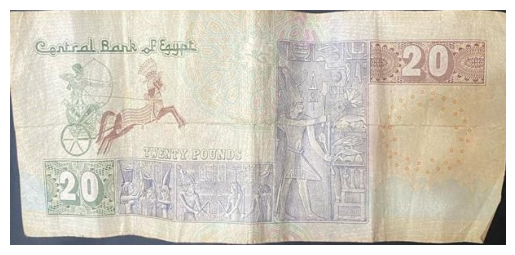

20EGP


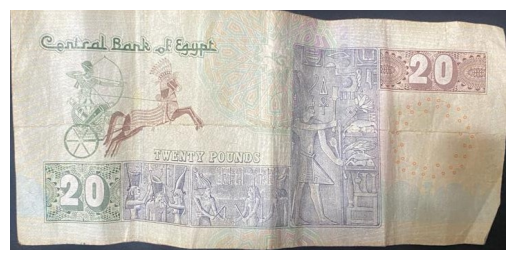

20EGP


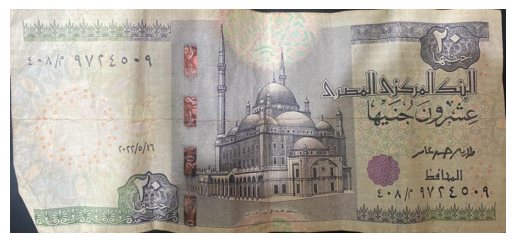

20EGP


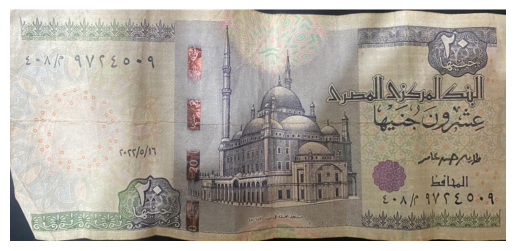

20EGP


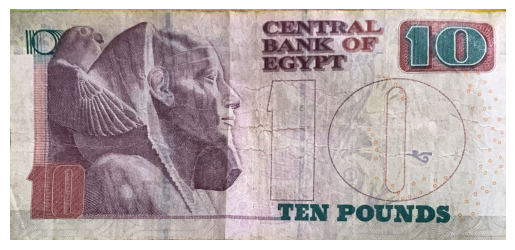

10EGP


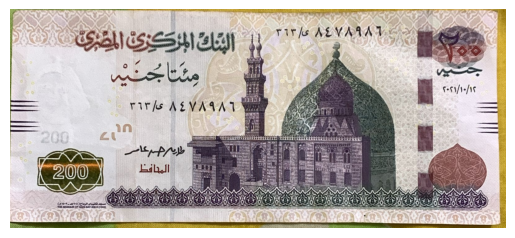

200EGP


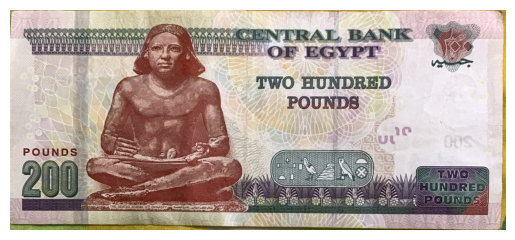

200EGP


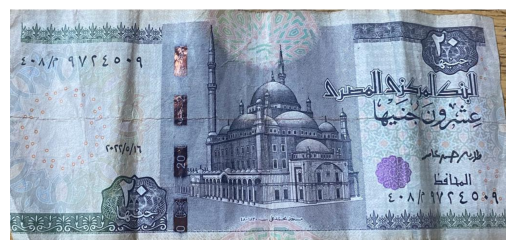

20EGP


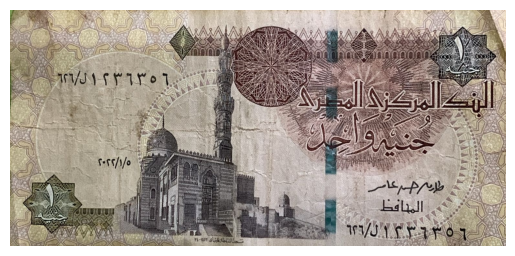

1EGP


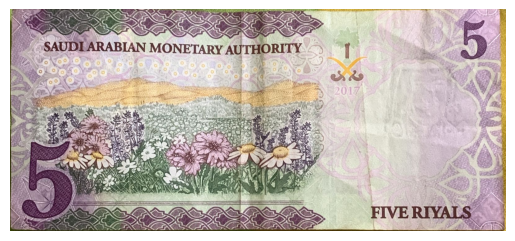

5SAR


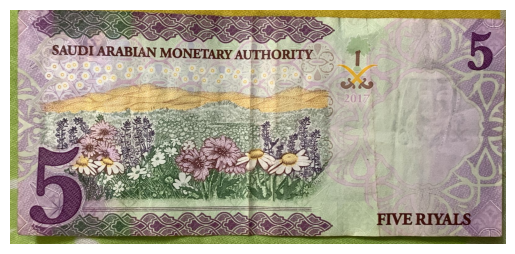

5SAR


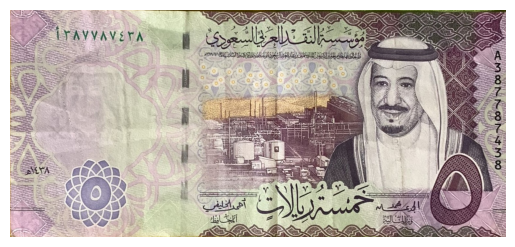

5SAR


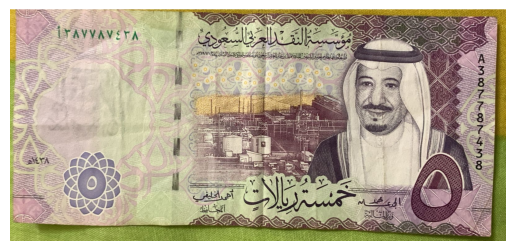

5SAR


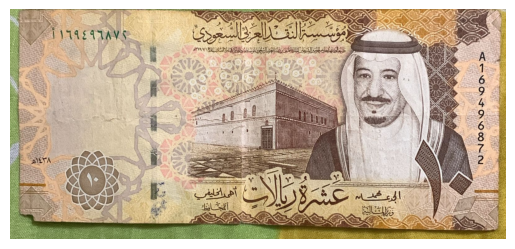

10SAR


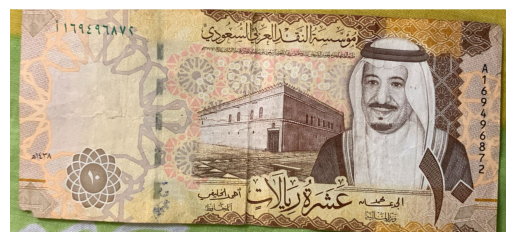

10SAR


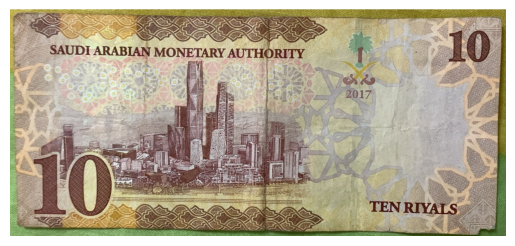

10SAR


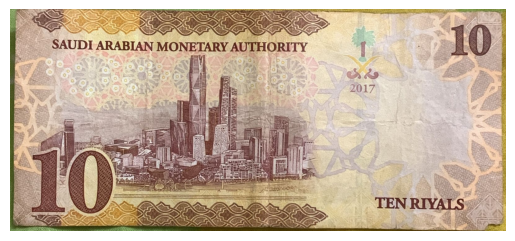

10SAR


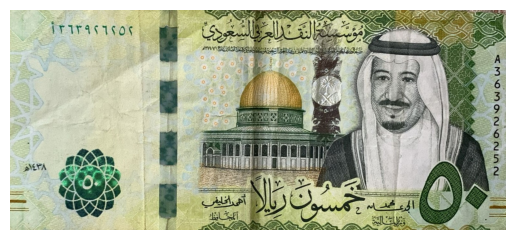

50SAR


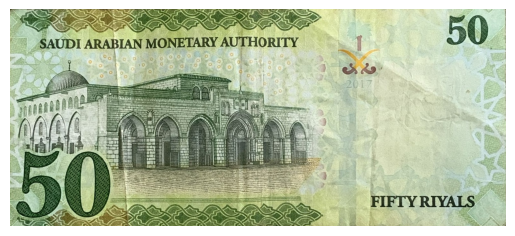

50SAR


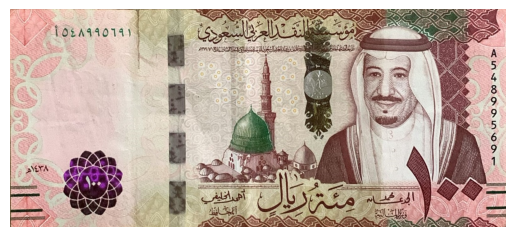

100SAR


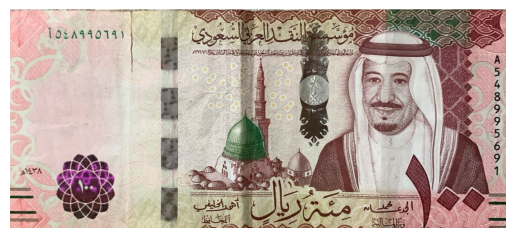

Please enter another image


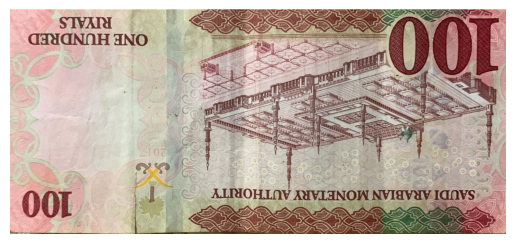

Please enter another image


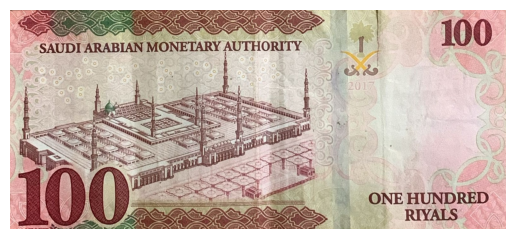

100SAR


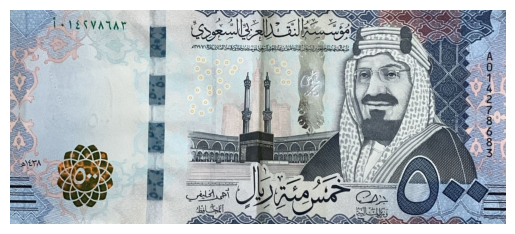

500SAR


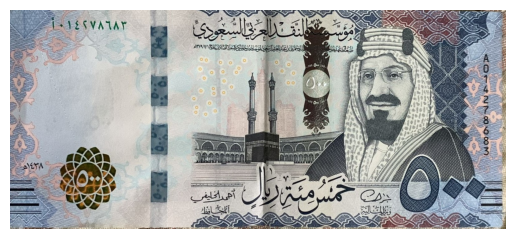

500SAR


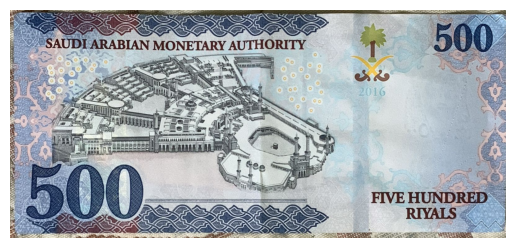

500SAR


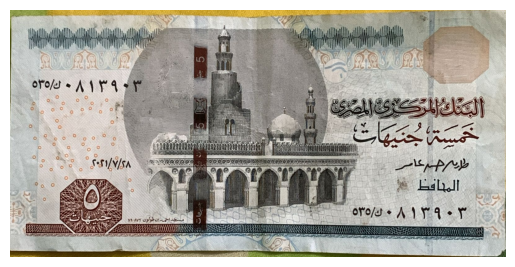

5EGP


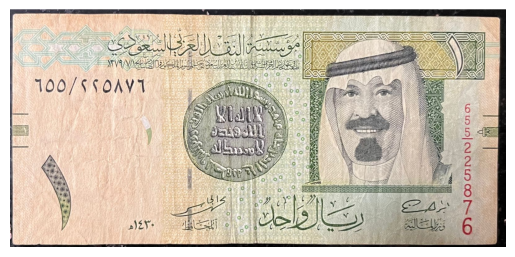

1SAR


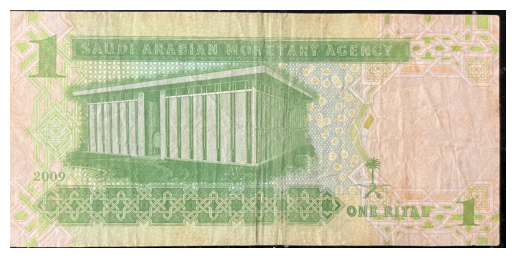

1SAR


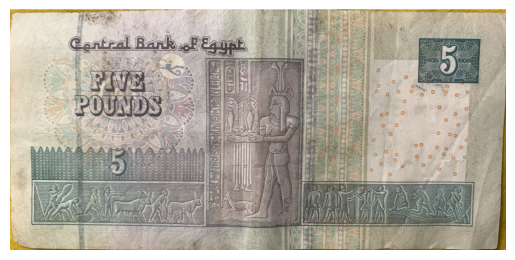

Please enter another image


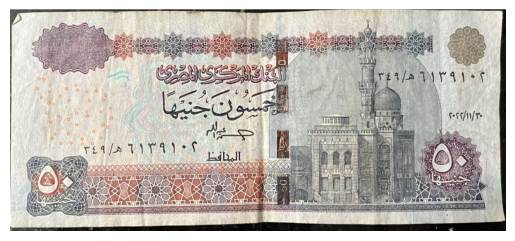

50EGP


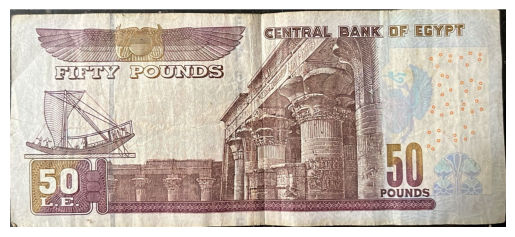

50EGP


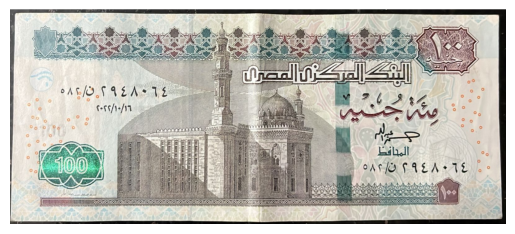

100EGP


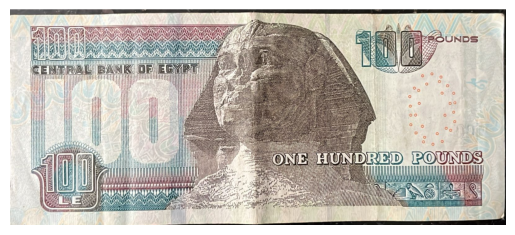

100EGP


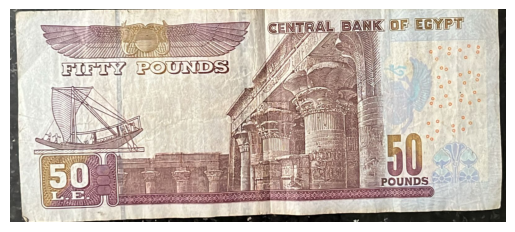

50EGP


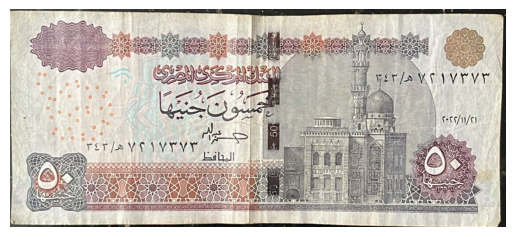

Please enter another image


In [6]:
import os
import cv2

# Define the path to the directory
dir_path = r'Testing Folder/'

# Get a list of all files in the directory
files = os.listdir(dir_path)

# Loop through each file
for file in files:
    # Construct the full path to the file
    file_path = os.path.join(dir_path, file)

    # Read the image
    img = cv2.imread(file_path)
    if img.shape[0] > img.shape[1]:
        img = rotating_image(img, 90) 
     # Convert the image from BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()
    # Apply the existing code to the image
    feat1=hist_hsv(img)
    selfimage = img_pre_processing(img)
    feat=HoG(selfimage)
    feat2=feat.reshape(1,-1)
    feat1=feat1.reshape(1,-1)
    classes=['1EGP','1SAR', '5EGP','5SAR','10EGP','10SAR','20EGP','50EGP','50SAR','100EGP','100SAR','200EGP','500SAR']
    Egyptian=[0,2,4,6,7,9,11]
    classes_EGP=['1EGP', '5EGP','10EGP','20EGP','50EGP','100EGP','200EGP']
    Saudi=[1,3,5,8,10,12]
    classes_SAR=['1SAR','5SAR','10SAR','50SAR','100SAR','500SAR']
    predictions = trained_model.predict(feat2)
    predictions = int(predictions)
    per=trained_model.predict_proba(feat2)
    max_pred=(np.max(per))
    max_pred=float(max_pred)
    if (max_pred*100 >= 70):
        print(classes[predictions])
    elif (max_pred*100 < 70  and max_pred*100 >= 40):
        if(predictions in Egyptian):
            predect= EGP_model.predict(feat2)
            per2=EGP_model.predict_proba(feat2)
            max_pred2=(np.max(per2))
            if (max_pred2*100 >= 75):
                predect = int(predect)
                print(classes_EGP[predect])
            else:
                print("Please enter another image")
        elif(predictions in Saudi):
            predect= SAR_model.predict(feat2)
            per2=SAR_model.predict_proba(feat2)
            max_pred2=(np.max(per2))
            if (max_pred2*100 >= 75):
                predect = int(predect)
                print(classes_SAR[predect])
            else:
                print("Please enter another image")
    else:
        print("Please enter another image")

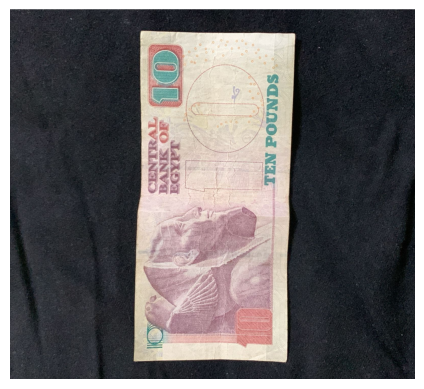

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


10EGP


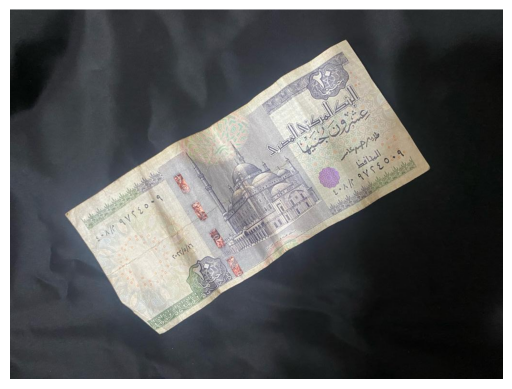

20EGP


C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


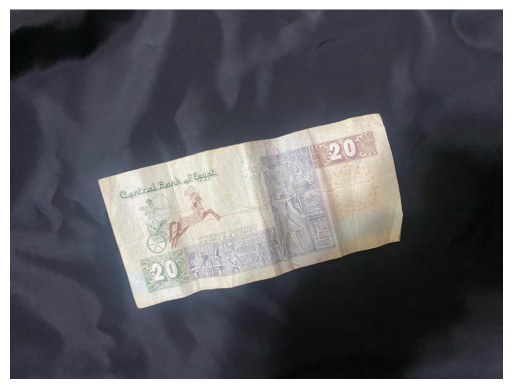

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


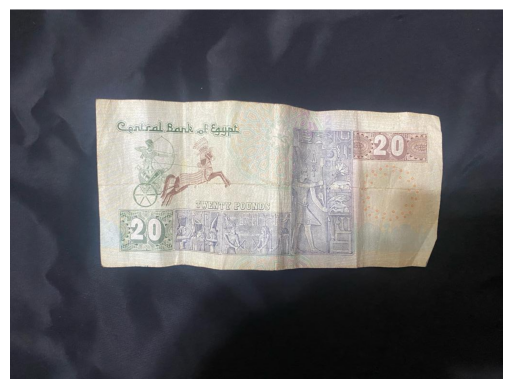

20EGP


C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


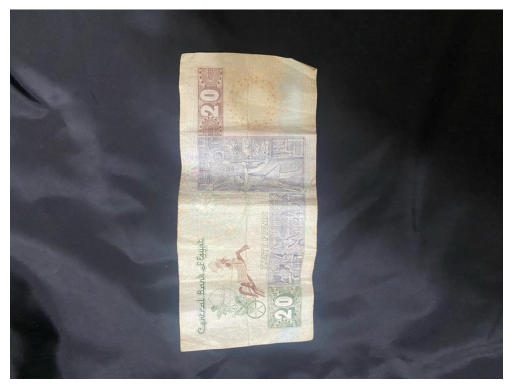

500SAR


C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


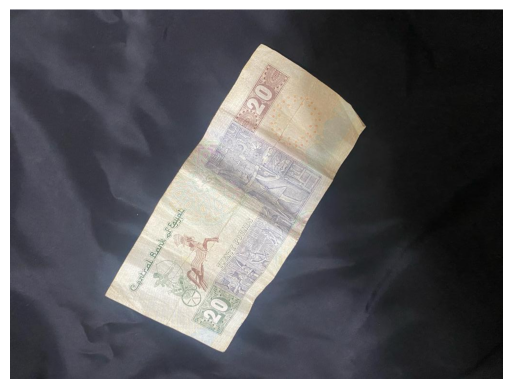

1EGP


C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


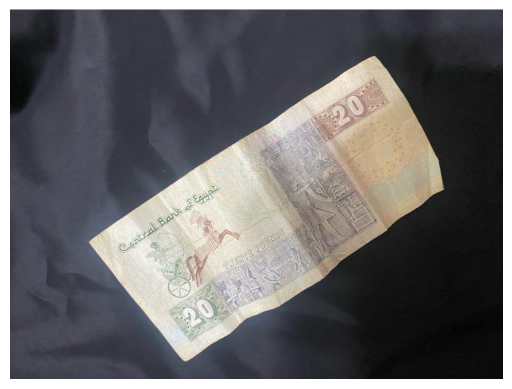

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


20EGP


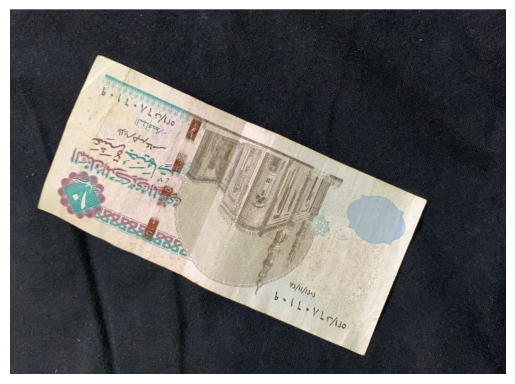

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


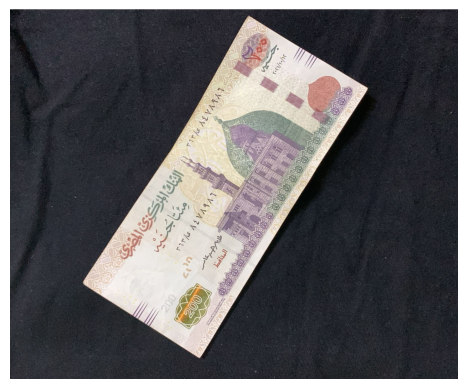

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


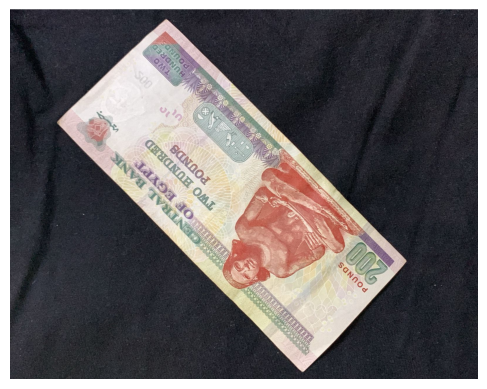

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


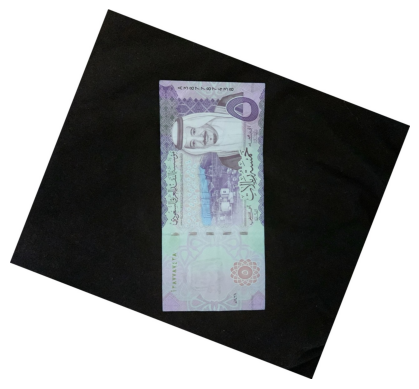

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


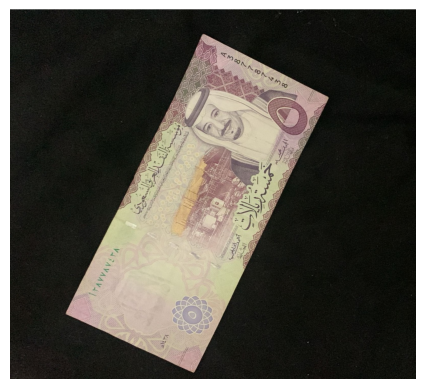

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


1EGP


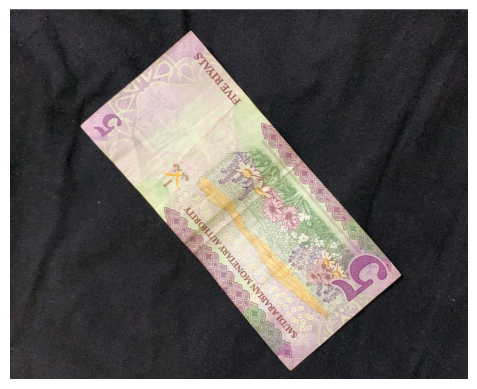

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


1EGP


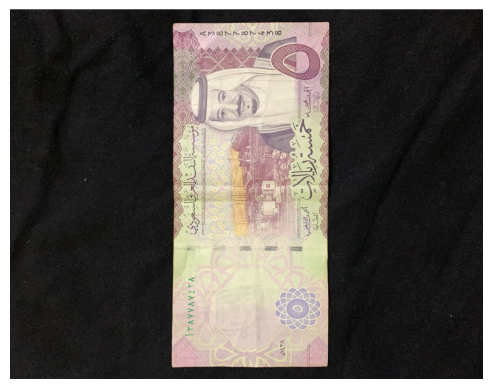

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


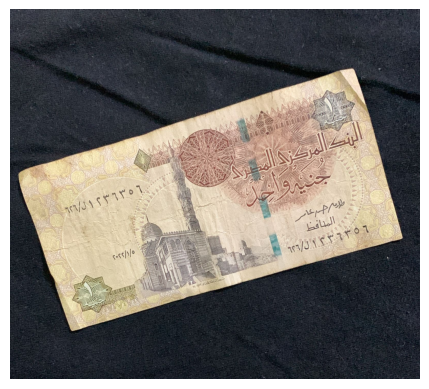

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


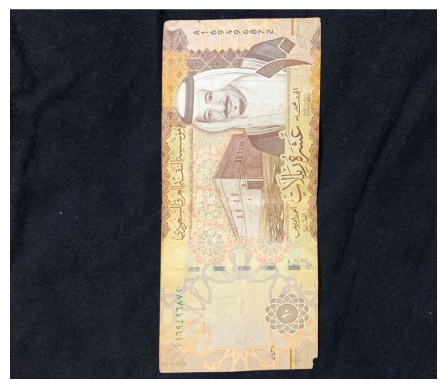

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


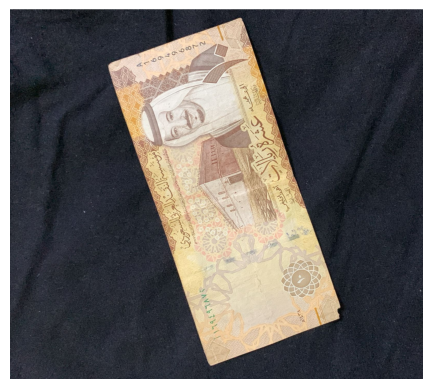

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


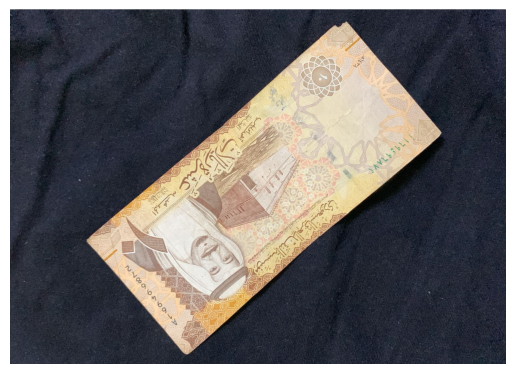

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


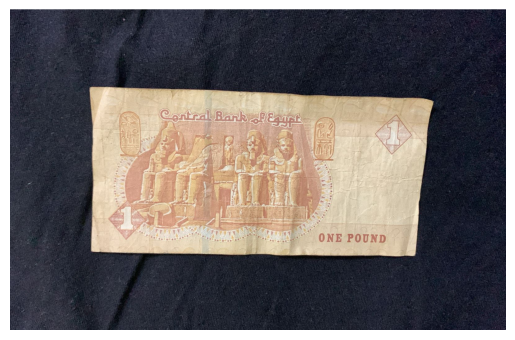

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


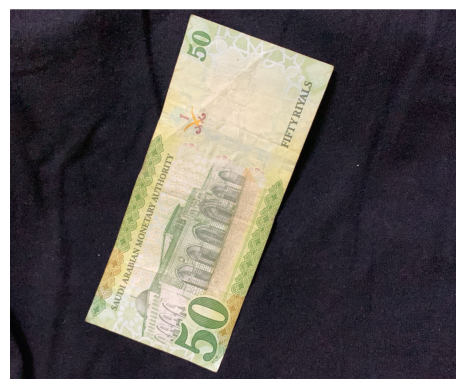

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


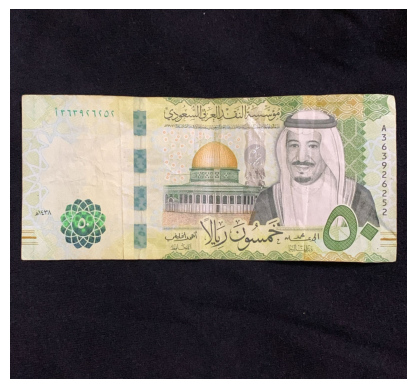

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


50SAR


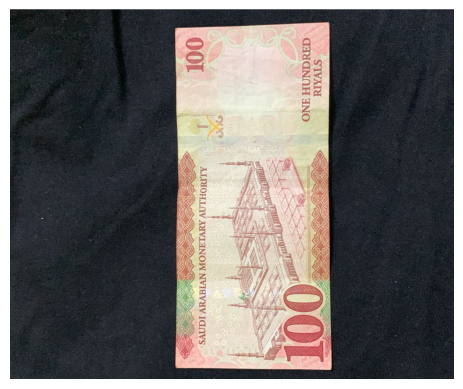

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


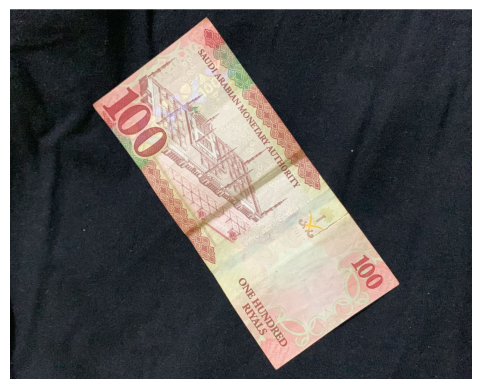

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


100SAR


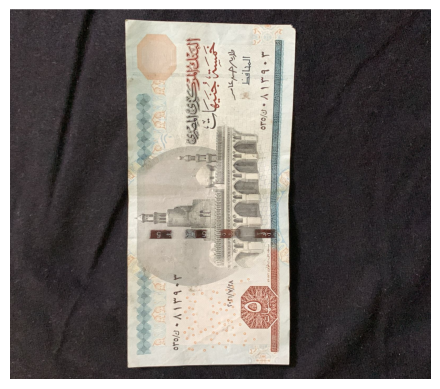

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


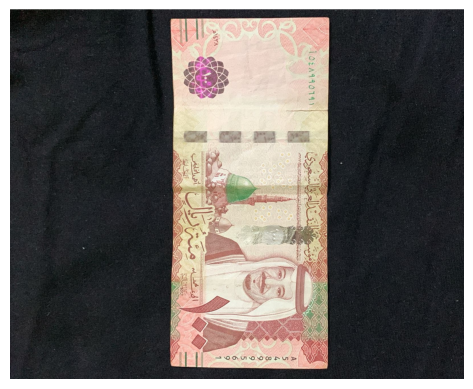

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


5SAR


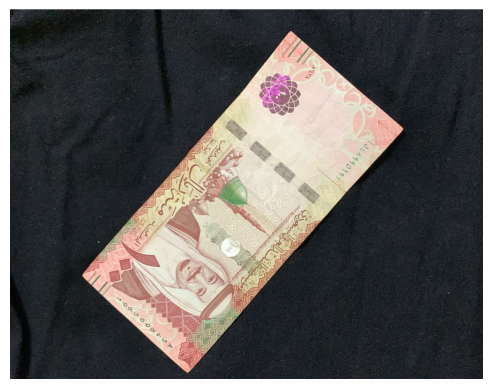

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


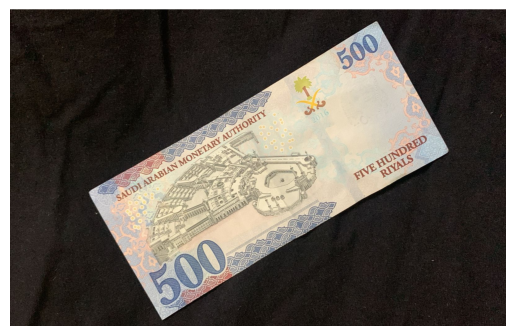

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


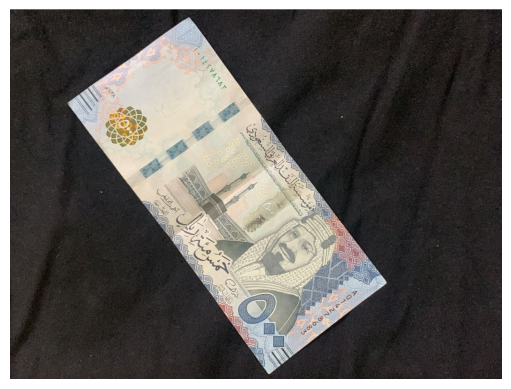

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


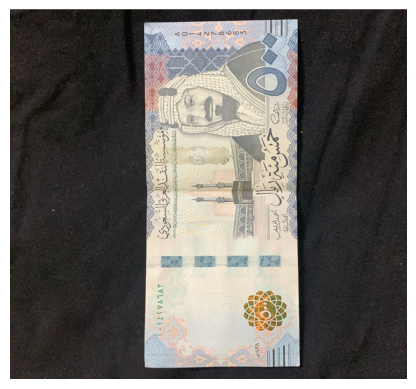

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


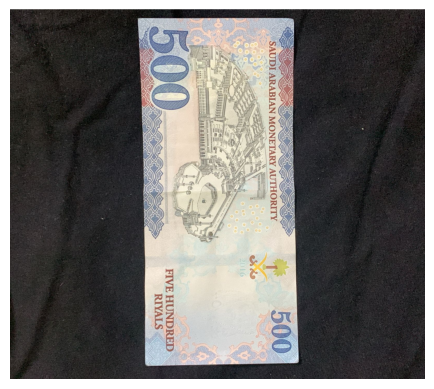

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


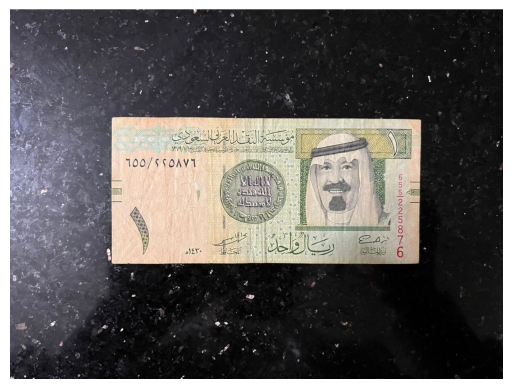

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


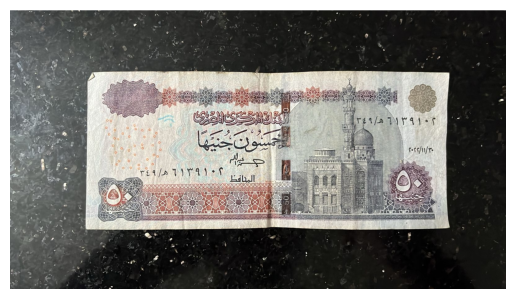

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


10SAR


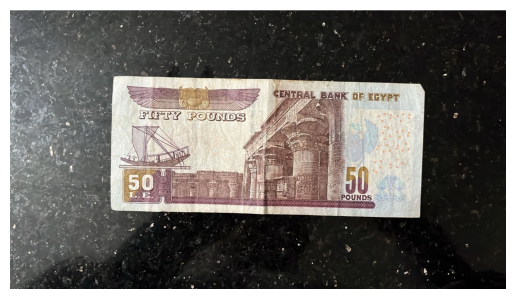

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


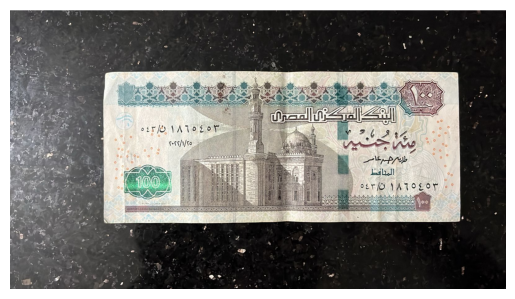

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


100EGP


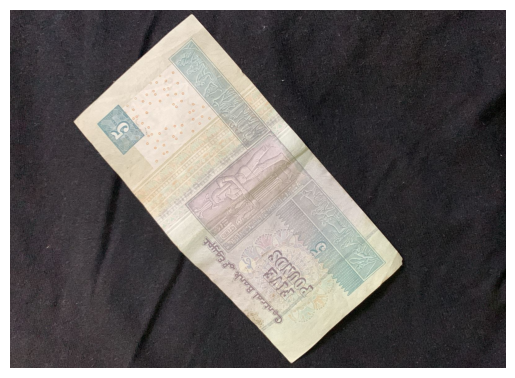

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


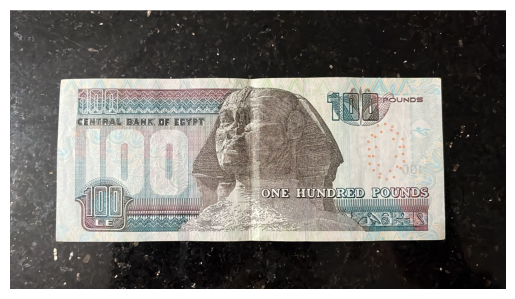

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


100EGP


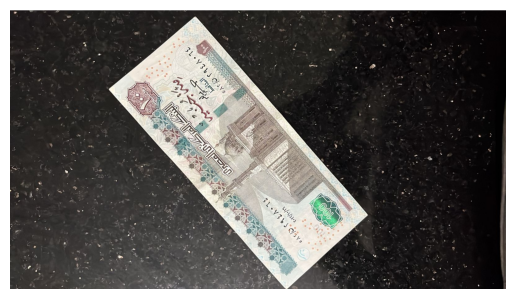

C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


Please enter another image


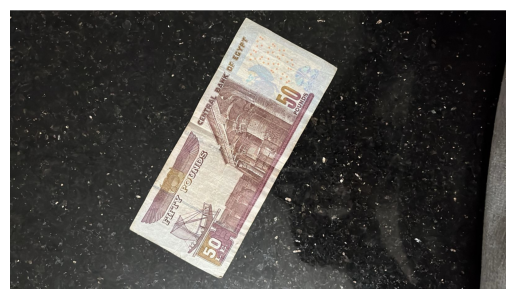

Please enter another image


C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:79: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box1 = np.int0(box1)
C:\Users\Khaled\AppData\Local\Temp\ipykernel_21488\2408342450.py:92: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box2 = np.int0(box2)


In [7]:
# Define the path to the directory
dir_path = r'C:/Users/Khaled/Desktop/Image project/Testing Folder-Background'

# Get a list of all files in the directory
files = os.listdir(dir_path)

# Loop through each file
for file in files:
    # Construct the full path to the file
    file_path = os.path.join(dir_path, file)

    # Read the image
    img = cv2.imread(file_path)
    if img.shape[0] > img.shape[1]:
        img = rotating_image(img, 90) 

    # Convert the image from BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()
    # Apply the existing code to the image
    feat1=hist_hsv(img)
    selfimage = Background_Removal(img)
    #show_images([selfimage],['Rotated and cropped'])
    feat=HoG(selfimage)
    feat2=feat.reshape(1,-1)
    feat1=feat1.reshape(1,-1)
    classes=['1EGP','1SAR', '5EGP','5SAR','10EGP','10SAR','20EGP','50EGP','50SAR','100EGP','100SAR','200EGP','500SAR']
    Egyptian=[0,2,4,6,7,9,11]
    classes_EGP=['1EGP', '5EGP','10EGP','20EGP','50EGP','100EGP','200EGP']
    Saudi=[1,3,5,8,10,12]
    classes_SAR=['1SAR','5SAR','10SAR','50SAR','100SAR','500SAR']
    predictions = trained_model.predict(feat2)
    predictions = int(predictions)
    per=trained_model.predict_proba(feat2)
    max_pred=(np.max(per))
    max_pred=float(max_pred)
    if (max_pred*100 >= 70):
        print(classes[predictions])
    elif (max_pred*100 < 70  and max_pred*100 >= 40):
        if(predictions in Egyptian):
            predect= EGP_model.predict(feat2)
            per2=EGP_model.predict_proba(feat2)
            max_pred2=(np.max(per2))
            if (max_pred2*100 >= 75):
                predect = int(predect)
                print(classes_EGP[predect])
            else:
                print("Please enter another image")
        elif(predictions in Saudi):
            predect= SAR_model.predict(feat2)
            per2=SAR_model.predict_proba(feat2)
            max_pred2=(np.max(per2))
            if (max_pred2*100 >= 75):
                predect = int(predect)
                print(classes_SAR[predect])
            else:
                print("Please enter another image")
    else:
        print("Please enter another image")